In [ ]:
#@title ###### Licensed to the Apache Software Foundation (ASF), Version 2.0 (the "License")

# Licensed to the Apache Software Foundation (ASF) under one
# or more contributor license agreements. See the NOTICE file
# distributed with this work for additional information
# regarding copyright ownership. The ASF licenses this file
# to you under the Apache License, Version 2.0 (the
# "License"); you may not use this file except in compliance
# with the License. You may obtain a copy of the License at
#
#   http://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing,
# software distributed under the License is distributed on an
# "AS IS" BASIS, WITHOUT WARRANTIES OR CONDITIONS OF ANY
# KIND, either express or implied. See the License for the
# specific language governing permissions and limitations
# under the License.

# 🗺 Land cover change

[![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/GoogleCloudPlatform/python-docs-samples/blob/main/people-and-planet-ai/land-cover-classification/land-cover-change.ipynb)

Let's visualize some regions throughout the years.

# 🎬 Before you begin

We first need to install all the requirements.

In [ ]:
!pip install --quiet --upgrade pip

In [ ]:
!pip install --quiet apache-beam

# Restart the runtime by ending the process.
exit()

# ☁️ My Google Cloud resources

Make sure you have followed these steps to configure your Google Cloud project:

1. Enable the APIs: _Earth Engine_

  <button>

  [Click here to enable the APIs](https://console.cloud.google.com/flows/enableapi?apiid=earthengine.googleapis.com)
  </button>

1. Register your
  [Compute Engine default service account](https://console.cloud.google.com/iam-admin/iam)
  on Earth Engine.

  <button>

  [Click here to register your service account on Earth Engine](https://signup.earthengine.google.com/#!/service_accounts)
  </button>

Once you have everything ready, you can go ahead and fill in your Google Cloud resources in the following code cell.
Make sure you run it!

In [1]:
from __future__ import annotations

import os
from google.colab import auth

auth.authenticate_user()

# Please fill in these values.
project = "" #@param {type:"string"}

# Quick input validations.
assert project, "⚠️ Please provide a Google Cloud project ID"

# Set GOOGLE_CLOUD_PROJECT for google.auth.default().
os.environ['GOOGLE_CLOUD_PROJECT'] = project

# Set the gcloud project for other gcloud commands.
!gcloud config set project {project}

Updated property [core/project].


In [ ]:
# Now let's get the code from GitHub and navigate to the sample.
!git clone https://github.com/GoogleCloudPlatform/python-docs-samples.git
%cd python-docs-samples/people-and-planet-ai/land-cover-classification

# 🗾 Visualize changes in the land

First we need to get some predictions in batch.
Since we only have a handful of predictions, we can run it locally in the notebook, but if we wanted more predictions we could run it on a distributed runner like [Dataflow](https://cloud.google.com/dataflow).

In [ ]:
# Run locally since we only need a handful of predictions.
!python predict_batch.py tensorflow \
  --model-path="pretrained-model" \
  --predictions-path="predictions"

In [90]:
# Here are the predictions we got.
!ls -lh predictions
!du -sh predictions

total 28K
drwxr-xr-x 2 root root 4.0K Oct  3 20:23 boardman-dams-removal
drwxr-xr-x 2 root root 4.0K Oct  3 20:22 borneo-oil-palms
drwxr-xr-x 2 root root 4.0K Oct  3 20:23 camp-fire
drwxr-xr-x 2 root root 4.0K Oct  3 20:23 coal-mine-wyoming
drwxr-xr-x 2 root root 4.0K Oct  3 20:23 rainforest-gold-mine
drwxr-xr-x 2 root root 4.0K Oct  3 20:23 salar-de-atacama
drwxr-xr-x 2 root root 4.0K Oct  3 20:48 ucayali-river-peru
169M	predictions


In [92]:
# Each location has all the inputs and predictions for every year.
!ls -lh predictions/ucayali-river-peru

total 24M
-rw-r--r-- 1 root root 3.8M Oct  3 20:48 2016-inputs.npz
-rw-r--r-- 1 root root  10K Oct  3 20:48 2016-predictions.npz
-rw-r--r-- 1 root root 3.8M Oct  3 20:48 2017-inputs.npz
-rw-r--r-- 1 root root  14K Oct  3 20:48 2017-predictions.npz
-rw-r--r-- 1 root root 3.9M Oct  3 20:48 2018-inputs.npz
-rw-r--r-- 1 root root  13K Oct  3 20:48 2018-predictions.npz
-rw-r--r-- 1 root root 3.9M Oct  3 20:48 2019-inputs.npz
-rw-r--r-- 1 root root  13K Oct  3 20:48 2019-predictions.npz
-rw-r--r-- 1 root root 3.9M Oct  3 20:48 2020-inputs.npz
-rw-r--r-- 1 root root  13K Oct  3 20:48 2020-predictions.npz
-rw-r--r-- 1 root root 3.8M Oct  3 20:48 2021-inputs.npz
-rw-r--r-- 1 root root  13K Oct  3 20:48 2021-predictions.npz


These are all _compressed NumPy files_.
We can easily load them with `numpy`.

In [113]:
import os
import numpy as np

def load(path: str, year: str, label: str) -> np.ndarray:
  with open(os.path.join(path, f"{year}-{label}.npz"), 'rb') as f:
    return np.load(f)[label]

inputs = load('predictions/ucayali-river-peru', '2020', 'inputs')
predictions = load('predictions/ucayali-river-peru', '2020', 'predictions')
print(f"inputs : {inputs.dtype.name} {inputs.shape}")
print(f"predictions : {predictions.dtype.name} {predictions.shape}")

inputs : float32 (512, 512, 13)
predictions : uint8 (512, 512, 1)


Aside from showing a grid of Sentinel 2 input images with their respective land cover classifications, we can us [`imageio`](https://imageio.readthedocs.io/en/stable/)
to create an _animated GIF_ of the land cover **change**.

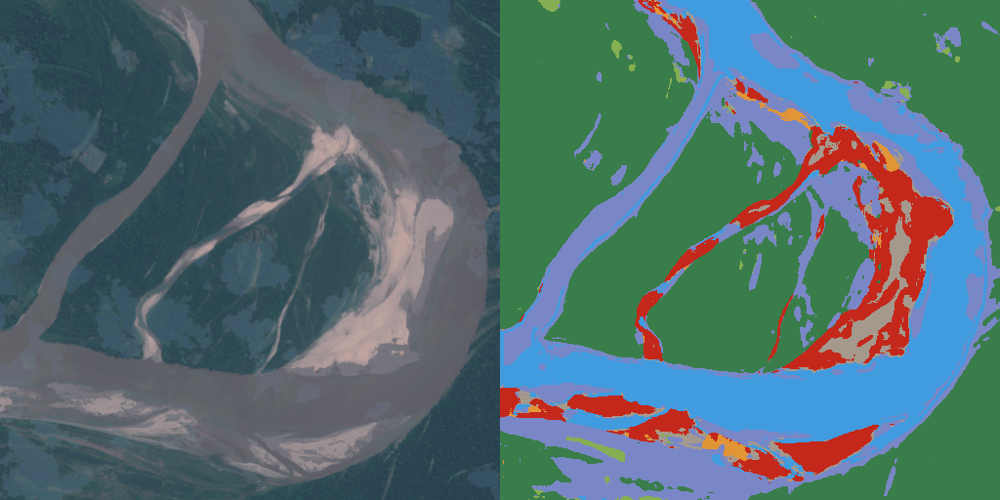

In [135]:
import IPython
import imageio
from plotly.graph_objects import Image
from plotly.subplots import make_subplots

from visualize import render_sentinel2, render_landcover, show_legend

def show_land_cover_change(path: str, max: float = 3000) -> None:
  # Get the years from the files and read the inputs and predictions.
  years = sorted({filename.split('-')[0] for filename in os.listdir(path)})
  inputs = [render_sentinel2(load(path, year, 'inputs'), max) for year in years]
  predictions = [render_landcover(load(path, year, 'predictions')) for year in years]

  # Plot one row for Sentinel 2 images, and another for land cover.
  fig = make_subplots(
      rows=2, cols=len(years), subplot_titles=years,
      shared_xaxes=True, shared_yaxes=True,
  )
  downsample_exp = 4  # make the images smaller to use less memory.
  for i, year in enumerate(years):
    inputs_small = inputs[i][::downsample_exp, ::downsample_exp]
    inputs_image = Image(z=inputs_small)
    fig.add_trace(inputs_image, row=1, col=i+1)

    predictions_small = predictions[i][::downsample_exp, ::downsample_exp]
    predictions_image = Image(z=predictions_small)
    fig.add_trace(predictions_image, row=2, col=i+1)
  fig.show()

  # Show an animated gif.
  gif_filename = os.path.join(path, 'land-cover-change.gif')
  frames = np.concatenate([inputs, predictions], axis=2)
  imageio.mimwrite(gif_filename, frames, duration=1)
  return IPython.display.Image(open(gif_filename, 'rb').read())

show_land_cover_change('predictions/ucayali-river-peru')

In [124]:
show_legend()

    💧 Water
    🌳 Trees
    🌾 Grass
    🌿 Flooded vegetation
    🚜 Crops
    🪴 Shrub and scrub
    🏗️ Built-up areas
    🪨 Bare ground
    ❄️ Snow and ice


# 🗺⏳ Explore locations through time

Finally we get to see our results.
We'll explore different regions in the world throughout the years to see how they've changed.

The **visualizations** shown are from the model we trained, your results might differ.
You can use the same model to explore different regions.
The pre-trained model is located at the
[`data/model`](data/model) directory.

## 🔥 Camp Fire in 2018, California

The [Camp Fire in 2018](https://en.wikipedia.org/wiki/Camp_Fire_(2018))
was the most destructive fire in the history of California.
It started near Camp Creek Road on early November 2018 and burned for almost the entire month.

The fire was ignited from a faulty electric transmission line and spreaded extremely fast with an extreme fire intensity.
It burned over 62,000 hectares (over 153,000 acres).
The total damage was estimated at \$16.5 billion USD.

> _The towns of Paradise and Concow were almost completely destroyed, each losing about 95% of their structures. The towns of Magalia and Butte Creek Canyon were also largely destroyed._
>
> -- [_"Camp Fire (2018)", Wikipedia_](https://en.wikipedia.org/wiki/Camp_Fire_(2018))
>
> ![Camp Fire in Magalia, California](https://s.hdnux.com/photos/01/06/65/36/18569132/3/ratio3x2_1200.jpg)
>
> -- _A firefighter on Magalia, California during the Camp Fire. Credit: Justin Sullivan for [SFGate](https://www.sfgate.com/california-wildfires/article/camp-fire-photos-anniversary-paradise-14814554.php)_

Going back to our earlier example, let's revisit the rural community of Concow in California.

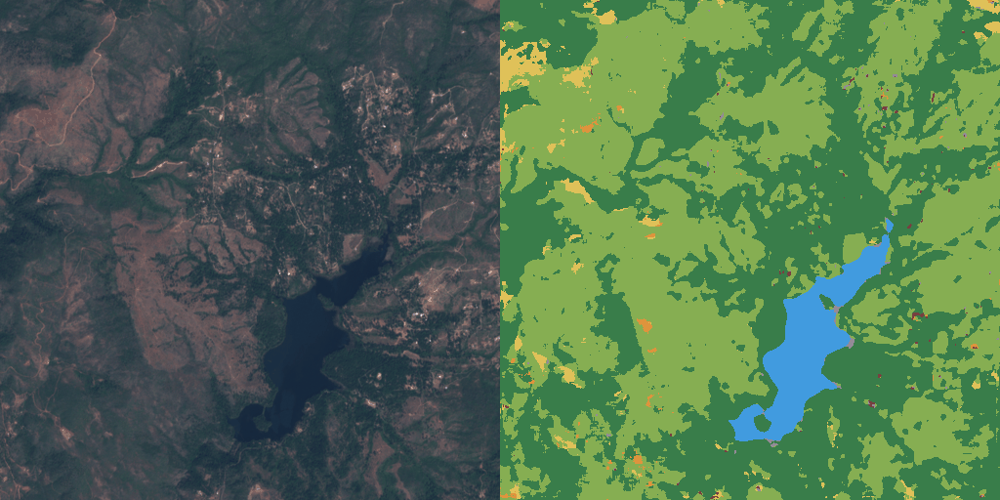

In [125]:
show_land_cover_change("predictions/camp-fire")

Unfortunately it's hard to predict where and when these natural distasters will happen.
Maybe we could train better models for that.

For now, we can see how they affected the area using land cover maps.
There was a dramatic change between 2018 and 2019.
The fire happened in at the end of 2018, in November.
For this example, we're using the yearly
[median](https://en.wikipedia.org/wiki/Median),
so we can see the changes reflected on 2019.

A lot of the _trees_ converted into _shrub and scrub_, and eventually into _grass_ when plants grew back.
An interesting thing to notice is that the land cover model associated a lot of the burned and damaged areas with _crops_.
Maybe there's something we can learn from the way we grow our food, it should look more green like _grass_ or even better, _trees_.

## 🌴 Palm oil plantations, Borneo

> _Grown only in the tropics, the oil palm tree produces high-quality oil used primarily for cooking in developing countries._
>
> _Palm oil is a very productive crop. It offers a far greater yield at a lower cost of production than other vegetable oils. Global production of and demand for palm oil is increasing rapidly. Plantations are spreading across Asia, Africa and Latin America. But such expansion comes at the expense of tropical forests — which form critical habitats for many endangered species and a lifeline for some human communities._
>
> -- [_World Wildlife Fund_](https://www.worldwildlife.org/industries/palm-oil)
>
> ![Fire clearing for palm oil](https://www.scidev.net/asia-pacific/wp-content/uploads/sites/4/2019/08/palm_oil-main.jpg)
>
> -- _Slash-and-burn to clear land for a palm oil plantation. Credit: David Gaveau for [SciDevNet](https://www.scidev.net/asia-pacific/opinions/satellites-check-oil-palm-expansion-in-borneo/)_

Tracking deforestation due to
[palm oil](https://en.wikipedia.org/wiki/Palm_oil)
or other plantations is not easy.
Satellite images help us see what's happening, but a land cover map can help us quantify these changes.

Sentinel-2 has a resoultion of 10 meters per pixel, but with higher resolution images we could distinguish the star-shaped leaves of the palm trees.

In this case, we're not classifying palm trees specifically, just _trees_.
Oil palm fruits have to be processed quickly before they rot, so the mills have to be nearby.
Deforestation happening near palm oil mills is _usually_ for palm oil.

Palm trees are also classified as _trees_, but we can see where forest _trees_ were cut down to plant palm trees.

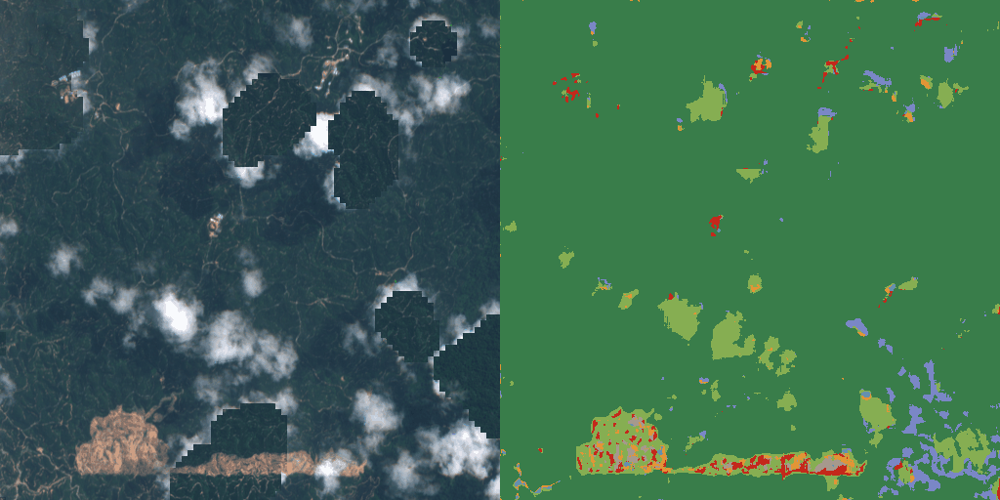

In [126]:
show_land_cover_change("predictions/borneo-oil-palms")

In 2016, it was mostly forest with small areas that were cut down where the young palm trees were placed.
During the following years we can see how the surrounding forest was cut down where they planted more palm.
It's classified as _grass_ since there's probably a lot of other plants growing being the tropics.
Through 2018 to 2021 we can see a river where palm tress can't grow, but the surrounding
[riparian zone](https://en.wikipedia.org/wiki/Riparian_zone) has been disturbed.
As the palm trees grow and mature, they're classified as _trees_ again in land cover, but it no longer holds the biodiversity it used to.

Fortunately, some of the major palm oil users like
[Nestlé](https://www.youtube.com/watch?v=gr2PKSEAC-M),
[Unilever](https://www.youtube.com/watch?v=OnU6NZMnSQQ), and
[Mondelēz](https://www.mondelezinternational.com/Snacking-Made-Right/ESG-Topics/Palm-Oil)
are working on using satellite imagery to make sure their supply chain is not promoting deforestation.

## ⛏ Gold mine, Peruvian Amazon

La Pampa was once one the **larges gold-mining** zone in the Peruvian Amazon in the Madre de Dios region.
Mercury is a toxic by-product of the mining operations.
Apparently, gold is almost everywhere there and you just need to pump _a lot_ of water, mix it with some mercury, and gold binds to it.
Anyone can do it, but unaware of the pollution to the environment as well as the health effects of exposure to mercury.
Mercury pollutes water sources and leads to neurological and kidney issues to anyone exposed to it.

> _All traces of the trees, vines and swamps that once covered this patch of the Amazon had vanished. In their place were sun-baked dunes and polluted ponds created by illegal gold-mining._
>
> -- [_"The scientists restoring a gold-mining disaster zone in the Peruvian Amazon", Nature_](https://www.nature.com/articles/d41586-020-00119-z)
>
> ![Illegal gold mining -- Nature](https://media.nature.com/lw800/magazine-assets/d41586-020-00119-z/d41586-020-00119-z_17618208.jpg)
>
> -- _Sand and ponds with mercury are the remains of what used to be rainforest. Credit: Brett Gundlock for [Nature](https://www.nature.com/articles/d41586-020-00119-z)_

There are
[ongoing efforts](https://earthobservatory.nasa.gov/images/148439/finding-gold-mining-hotspots-in-peru)
to find new small scale gold mining operations operated by _garimperos_, since they are creating a larger environmental footprint than industrial mines.

Many of these mines are now abandoned.
Researchers and environmentalists are evaluating the damage and coming up with strategies to heal back the ecosystem.

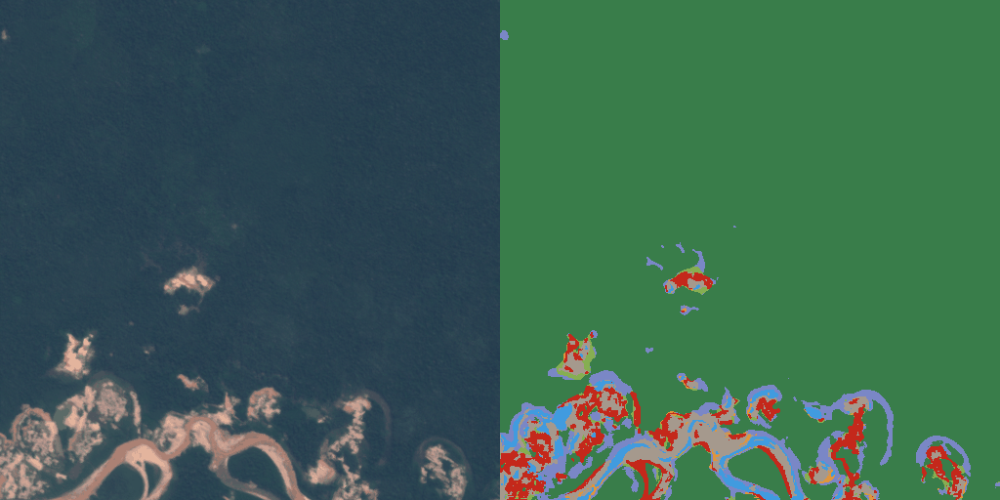

In [127]:
show_land_cover_change("predictions/rainforest-gold-mine")

We can clearly see the sand pools with water contaminated by mercury.
The land cover map shows them mostly as _bare land_ with pools of _water_.
It's most likely polluting the river since they come into contact, and that river is a source of water for the wildlife and indigenous communites.

## 🪫 Lithium mining, Chile

Electric vehicles have become more and more popular as we're phasing out from gasoline and fossil fuels.
With the increase of demand for electric vehicles, has come the increase of demand for lithium for the batteries.

Lithium itself is **not** a rare Earth metal, it's actually one of the most common elements in Earth.
It's abundantly found in salt flats, rocks, sand and clay.
[Cobalt](https://www.washingtonpost.com/graphics/business/batteries/congo-cobalt-mining-for-lithium-ion-battery/) and
[nickel](https://www.theguardian.com/sustainable-business/2017/aug/24/nickel-mining-hidden-environmental-cost-electric-cars-batteries)
are more worrysome, but fortunately many battery manufacturers are researching ways to minimize or remove their use.

Some of the richest lithium deposits are located in the Atacama desert in Chile and Argentina.
It's one of the driest places on Earth, but there are pools of water rich in dissolved salts, particularly lithium salts.
The conditions here result in an efficient extraction process, but uses and pollutes a lot of the water.
Atacamas and other local communities rely or used to rely, on these ancestral lands for water.

> ![Water pools rich in lithium salts](https://img.washingtonpost.com/rf/image_1200w/2010-2019/WashingtonPost/2016/12/07/Others/Images/2016-12-06/onlinearg001.JPG)
>
> -- _These pools are called "eyes" and local indigenous communities have a spiritual connection with them. Credit: Michael Robinson Chavez for [The Washington Post](https://www.washingtonpost.com/graphics/business/batteries/tossed-aside-in-the-lithium-rush/)_

Here's a view of the
[Salar de Atacama](https://www.usgs.gov/media/before-after/lithium-mining-salar-de-atacama-chile),
one of the largest lithium mines in Chile.

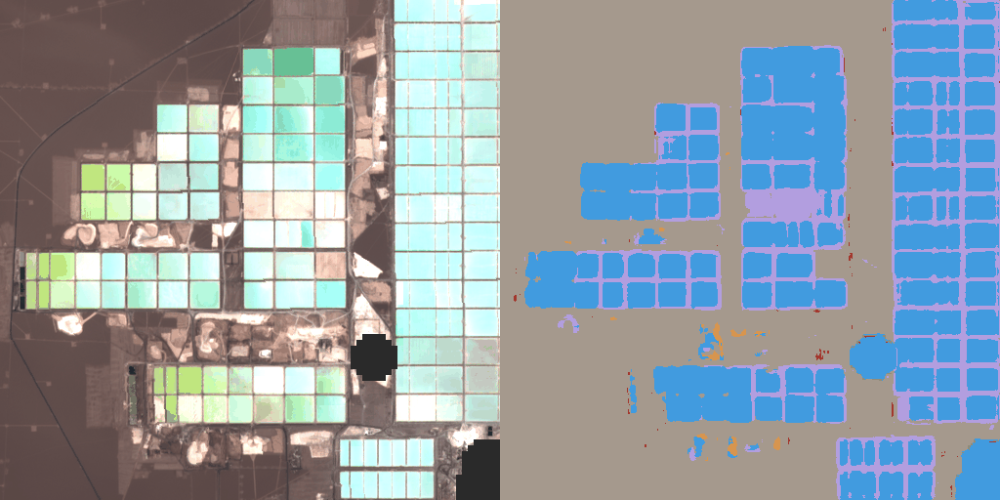

In [132]:
show_land_cover_change("predictions/salar-de-atacama", max=6000)

It almost ressembles an alien landscape.
We can see large amounts of rectangular pools of salts brine as _water_ in the middle of the salt flats desert shown as _bare ground_.

With the increase for demand of lithium and an inevitable increase in price, there has been active research in more environmentally friendly ways to get lithium.
For example, Tesla has been working on a
[lithium extraction process involving only table salt](https://electrek.co/2021/07/09/tesla-patent-reveals-elon-musk-table-salt-lithium-extraction-process/)
instead of acids, making it non-toxic.
This also allows to re-use the same water in a closed system, drastically reducing the use of water and leaching into the environment.
The new process efficiently extracts lithium from clay in the dirt, so it doesn't require salt flats or other special locations.

> _"What is the best way to take the ore and extract the lithium and do so in an environmentally-friendly way? ... We found that we can actually use table salt, sodium chloride, to basically extract the lithium from the ore... We take a chunk of dirt in the ground, extract the lithium, and put the chunk of dirt back where it was. It will look pretty much the same as before."_
>
> -- _Elon Musk, quote from [electrek](https://electrek.co/2021/07/09/tesla-patent-reveals-elon-musk-table-salt-lithium-extraction-process/)_

## 🏭 Coal mine, Wyoming

Here's a small section of a
[coal mine in Wyoming](https://en.wikipedia.org/wiki/Coal_mining_in_Wyoming)
located at the
[Powder River Basin](https://en.wikipedia.org/wiki/Powder_River_Basin).

Coal has been widely used to **generate electricity**, as well as steel and cement processing.
But there has been a rise in the adoption of renewable sources of energe.

> _The coal mining industry has a long history of significant negative [environmental impacts] on local ecosystems, health impacts on local communities and workers, and contributes heavily to the global environmental crises, such as [poor air quality] and [climate change]._
> _For these reasons, coal has been one of the [first fossil fuels to be phased out] of various parts of the [global energy economy]._
>
> -- [_Coal mining, Wikipedia_](https://en.wikipedia.org/wiki/Coal_mining)
>
> ![Powder River Basin mine](https://npr.brightspotcdn.com/dims4/default/15ea139/2147483647/strip/true/crop/626x386+0+31/resize/880x542!/quality/90/?url=http%3A%2F%2Fnpr-brightspot.s3.amazonaws.com%2Flegacy%2Fsites%2Fkufm%2Ffiles%2F201504%2Fcoal_shovel.700.jpg)
>
> -- _A coal mine at the Powder River Basin in Wyoming. Credit: Clay Scott for [Montana Public Radio](https://www.mtpr.org/arts-culture/2015-04-20/western-coal-country-voices-from-the-powder-river-basin)_

[environmental impacts]: https://en.wikipedia.org/wiki/Health_and_environmental_impact_of_the_coal_industry
[poor air quality]: https://en.wikipedia.org/wiki/Air_pollution
[climate change]: https://en.wikipedia.org/wiki/Climate_change
[first fossil fuels to be phased out]: https://en.wikipedia.org/wiki/Fossil_fuel_phase-out
[global energy economy]: https://en.wikipedia.org/wiki/Energy_industry

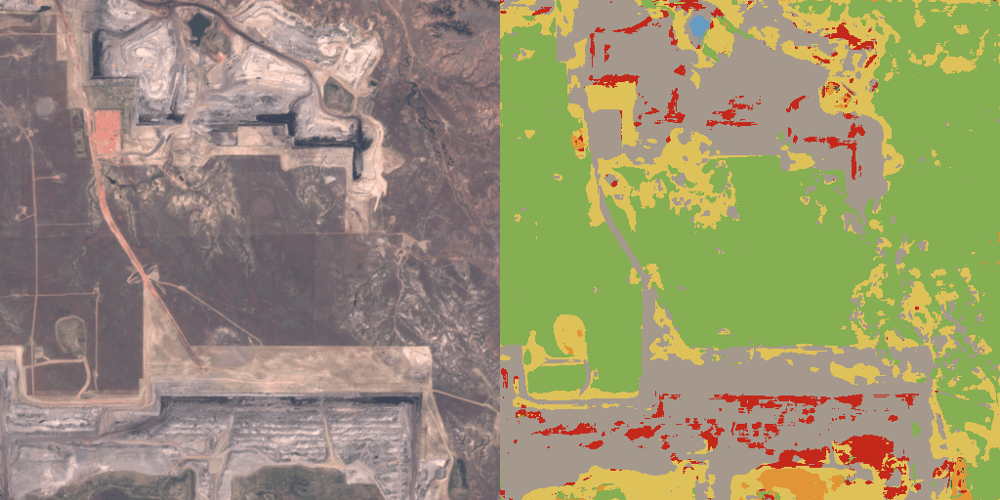

In [133]:
show_land_cover_change("predictions/coal-mine-wyoming")

Even though the overall mine has gotten bigger, it looks like they've been gradually filling up some parts of open ground.
It's still interesting to note that the sloped and stepped landscape is sometimes confused like _built up_.
I guess it's similar in that it has very hard corners.

## 🌊 River dams removal

Human-made dams act as **barriers on a river.**
They have been used as a renewable source of energy.
Unfortunately, they have a **high impact on the surrounding ecosystems.**
They cause the area before the dam to flood, while the area after the dam dries up, affecting both the wildlife and the local communities that rely on the river.
They also prevent migratory fish and other species to reach their feeding and breeding habitats, which is leading to the extinction of more fish species.

> _"In 1999, history was made as efforts began to remove the Edwards Dam on the Kennebec River in Augusta, Maine... Today, iconic and important fish species that were once threatened or had altogether disappeared upstream—species like American shad, Atlantic and short-nosed sturgeon, Atlantic salmon, striped bass, American eel and river herring—are once again found in abundance here for the first time since the Edwards Dam was built in 1837."_
>
> -- _["Removing Barriers for Healthy Rivers and Fisheries", Nature](https://www.nature.org/en-us/what-we-do/our-priorities/tackle-climate-change/climate-change-stories/removing-barriers-river-health/)_
>
> ![Boardman River restoration project](https://www.americanrivers.org/wp-content/uploads/2020/01/BoardmanRiverRestorationProject_USACE-1600x629.jpg)
>
> -- _Boardman River restoration project. Credit: Photo by USACE on [American Rivers](https://www.americanrivers.org/boardman-river-dams/)_

Two dams were removed, one in 2017 and the other in 2018.
This project has helped to restore Blue Ribbon trout habitat.

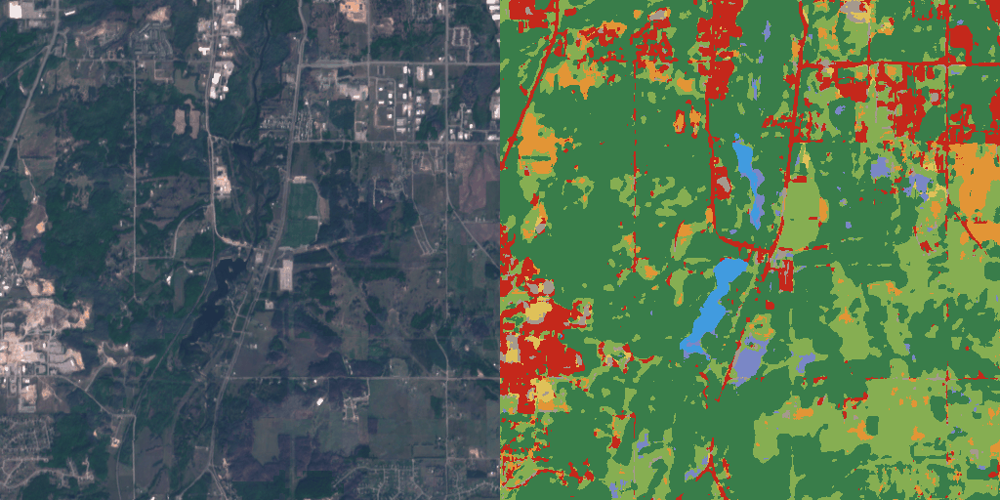

In [134]:
show_land_cover_change("predictions/boardman-dams-removal")

Here we can clearly see two ponds of _water_ in 2016.
The lower one is draining during 2017 and the upper one drains on 2018.

Interestingly, the model classified the rivers as _built up_, probably because they are surrounded by sand and probably look like roads.
Maybe more training points on how rivers and roads look like could help with this.